<a href="https://colab.research.google.com/github/Geomiata/Prueba/blob/main/GasteinValley_weighted_v2_200days_80_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

$\Large\color{blue}{\text{PyGMTSAR 2024 Gastein Valley, Austria}}$
$\Large\color{blue}{\text{Sentinel-1 Scenes Downloading from Alaska Satellite Facility (ASF)}}$

### Look for more PyGMTSAR examples:

* Google Colab - see GitHub page for [notebooks](https://github.com/mobigroup/gmtsar),

* Docker Images on [DockerHub](https://hub.docker.com/r/mobigroup/pygmtsar),

* GitHub [notebooks](https://github.com/mobigroup/gmtsar/tree/master/notebooks),

* GitHub Actions [console scripts](https://github.com/mobigroup/gmtsar/actions),

* Google Cloud VM -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/),

* Linux Debian and Ubuntu -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/),

* Apple Silicon and Intel hosts -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/).


### PyGMTSAR InSAR library, Geomed3D Geophysical Inversion Library, N-Cube 3D/4D GIS Data Visualization, etc. are my free-time Open Source projects.

I have STEM master’s degree in radio physics and in 2004 I have got the first prize of the All-Russian Physics competition for significant results in forward and inverse modeling for non-linear optics and holography, also applicable for modeling of Gravity, Magnetic, and Thermal fields and satellite interferometry processing. And I’m data scientist and software developer with 20 year’s experience in science and industrial development. I had been working on government contracts and universities projects and on projects for LG Corp, Google Inc, etc.

### You can sponsor my work on [Patreon](https://www.patreon.com/pechnikov) where I share my projects updates, publications, use cases, examples, and other useful information. To order some research and development and support, see my profile on freelance platform [Upwork](https://www.upwork.com/freelancers/~01e65e8e7221758623).

### Resources

* [Patreon](https://www.patreon.com/pechnikov),

* [YouTube Geological Models](https://www.youtube.com/channel/UCSEeXKAn9f_bDiTjT6l87Lg),

* [Virtual and Augmented Reality (VR/AR) Geological Models](https://mobigroup.github.io/ParaView-Blender-AR/),

* [GitHub](https://github.com/mobigroup),

* [LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/),

* [Medium](https://medium.com/@pechnikov),

* [Habr](https://habr.com/ru/users/N-Cube/posts/).

### @ Alexey Pechnikov, 2023

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Load Modules to Check Environment

In [ ]:
import platform, sys, os

## Google Colab Installation

### Install GMTSAR
https://github.com/gmtsar/gmtsar

In [ ]:
if 'google.colab' in sys.modules:
    count = !ls /usr/local | grep GMTSAR | wc -l
    if count == ['0']:
        !export DEBIAN_FRONTEND=noninteractive
        !apt-get update > /dev/null
        !apt install -y csh autoconf gfortran \
            libtiff5-dev libhdf5-dev liblapack-dev libgmt-dev gmt-dcw gmt-gshhg gmt  > /dev/null
        # GMTSAR codes are not so good to be compiled by modern GCC
        !apt install gcc-9 > /dev/null
        !update-alternatives --install /usr/bin/gcc gcc /usr/bin/gcc-9 10
        !update-alternatives --config gcc
        !gcc --version | head -n 1
        !rm -fr /usr/local/GMTSAR
        !git config --global advice.detachedHead false
        !cd /usr/local && git clone -q --branch master https://github.com/gmtsar/gmtsar GMTSAR
        # revert recent broken commit
        !cd /usr/local/GMTSAR && git checkout e98ebc0f4164939a4780b1534bac186924d7c998 > /dev/null
        !cd /usr/local/GMTSAR && autoconf > /dev/null
        !cd /usr/local/GMTSAR && ./configure --with-orbits-dir=/tmp > /dev/null
        !cd /usr/local/GMTSAR && make 1>/dev/null 2>/dev/null
        !cd /usr/local/GMTSAR && make install >/dev/null
        # fix for missed script, use bash instead of csh interpretator
        # note: csh messes stdout and stderr in Docker environment, it's resolved in PyGMTSAR code
        !echo '#!/bin/sh' > /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !echo echo /usr/local/GMTSAR/share/gmtsar >> /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !chmod a+x /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !/usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        # test one GMTSAR binary
        !/usr/local/GMTSAR/bin/make_s1a_tops 2>&1 | head -n 2

In [ ]:
import sys
if 'google.colab' in sys.modules:
    !apt install -y xvfb > /dev/null
    !{sys.executable} -m pip install pyvista xvfbwrapper > /dev/null
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()

### Define ENV Variables for Jupyter Instance

In [ ]:
# use default GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

env: PATH=/opt/bin:/usr/local/nvidia/bin:/usr/local/cuda/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/tools/node/bin:/tools/google-cloud-sdk/bin:/usr/local/GMTSAR/bin/


### Install Python Modules

In [ ]:
!{sys.executable} --version

Python 3.10.12


In [ ]:
if 'google.colab' in sys.modules:
    !{sys.executable} -m pip install -q git+https://github.com/mobigroup/gmtsar.git@pygmtsar2#subdirectory=pygmtsar

  Preparing metadata (setup.py) ... done


## Load and Setup Python Modules

In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import json
from dask.distributed import Client
import dask
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# plotting modules
import pyvista as pv
# magic trick for white background
pv.set_plot_theme("document")
import panel
panel.extension('vtk')
#import seaborn as sns
#import adjustText
import matplotlib.pyplot as plt
#import matplotlib
%matplotlib inline

In [ ]:
# define Pandas display settings
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 100)
pd.set_option('display.max_colwidth', 100)

In [ ]:
from pygmtsar import S1, Stack, tqdm_dask, NCubeVTK, ASF, XYZTiles

## Define Sentinel-1 SLC Scenes and Processing Parameters

When you need more scenes and SBAS analysis  see examples on PyGMTSAR GitHub page https://github.com/mobigroup/gmtsar

### Descending Orbit Configuration

In [ ]:
SCENES = """
S1A_IW_SLC__1SDV_20210516T165914_20210516T165941_037916_047989_3ECF
S1A_IW_SLC__1SDV_20210528T165915_20210528T165942_038091_047ED3_A599
S1A_IW_SLC__1SDV_20210609T165916_20210609T165943_038266_0483FE_CD3F
S1A_IW_SLC__1SDV_20210621T165916_20210621T165943_038441_04893A_824A
S1A_IW_SLC__1SDV_20210703T165917_20210703T165944_038616_048E78_FB30
S1A_IW_SLC__1SDV_20210715T165918_20210715T165945_038791_0493BD_1F11
S1A_IW_SLC__1SDV_20210727T165918_20210727T165945_038966_0498FF_08A1
S1A_IW_SLC__1SDV_20210808T165919_20210808T165946_039141_049E87_DEAB
S1A_IW_SLC__1SDV_20210820T165920_20210820T165947_039316_04A493_136B
S1A_IW_SLC__1SDV_20210901T165920_20210901T165947_039491_04AA91_78BC
S1A_IW_SLC__1SDV_20210913T165921_20210913T165948_039666_04B0A2_A6D0
S1A_IW_SLC__1SDV_20210925T165921_20210925T165948_039841_04B688_8E6D
S1A_IW_SLC__1SDV_20211007T165922_20211007T165949_040016_04BC94_36E3
S1A_IW_SLC__1SDV_20211019T165922_20211019T165949_040191_04C2B3_F9C6
S1A_IW_SLC__1SDV_20211031T165922_20211031T165949_040366_04C8C5_358E
S1A_IW_SLC__1SDV_20211112T165921_20211112T165948_040541_04CEDB_D749
S1A_IW_SLC__1SDV_20211124T165921_20211124T165948_040716_04D4EA_F772
S1A_IW_SLC__1SDV_20211206T165920_20211206T165947_040891_04DAFD_F7DE
S1A_IW_SLC__1SDV_20211218T165920_20211218T165947_041066_04E0EF_20EC
S1A_IW_SLC__1SDV_20211230T165919_20211230T165946_041241_04E6B7_4503
S1A_IW_SLC__1SDV_20220111T165919_20220111T165946_041416_04ECAD_3E29
S1A_IW_SLC__1SDV_20220123T165918_20220123T165945_041591_04F274_62B6
S1A_IW_SLC__1SDV_20220204T165918_20220204T165945_041766_04F863_D1BC
S1A_IW_SLC__1SDV_20220216T165918_20220216T165945_041941_04FE8E_CFF3
S1A_IW_SLC__1SDV_20220228T165917_20220228T165944_042116_05048B_5823
S1A_IW_SLC__1SDV_20220312T165918_20220312T165945_042291_050A7E_EDE5
S1A_IW_SLC__1SDV_20220324T165918_20220324T165945_042466_051073_833E
S1A_IW_SLC__1SDV_20220405T165918_20220405T165945_042641_05165F_B58D
S1A_IW_SLC__1SDV_20220417T165918_20220417T165945_042816_051C40_3336
S1A_IW_SLC__1SDV_20220429T165919_20220429T165946_042991_0521FB_302F
S1A_IW_SLC__1SDV_20220511T165920_20220511T165947_043166_0527BE_11DC
S1A_IW_SLC__1SDV_20220604T165922_20220604T165949_043516_05321B_8865
S1A_IW_SLC__1SDV_20220616T165922_20220616T165949_043691_053750_435F
S1A_IW_SLC__1SDV_20220628T165923_20220628T165950_043866_053C94_DC6C
S1A_IW_SLC__1SDV_20220710T165924_20220710T165951_044041_0541C2_0BC7
S1A_IW_SLC__1SDV_20220722T165924_20220722T165951_044216_0546FE_1500
S1A_IW_SLC__1SDV_20220803T165925_20220803T165952_044391_054C28_3021
S1A_IW_SLC__1SDV_20220815T165926_20220815T165953_044566_0551A9_CD43
S1A_IW_SLC__1SDV_20220827T165926_20220827T165953_044741_055794_DA92
S1A_IW_SLC__1SDV_20220908T165927_20220908T165954_044916_055D72_EA36
S1A_IW_SLC__1SDV_20220920T165927_20220920T165954_045091_05635E_2A17
S1A_IW_SLC__1SDV_20221002T165928_20221002T165955_045266_05693B_EB8A
S1A_IW_SLC__1SDV_20221014T165928_20221014T165955_045441_056F18_AAEB
S1A_IW_SLC__1SDV_20221026T165928_20221026T165955_045616_05744A_9471
S1A_IW_SLC__1SDV_20221107T165927_20221107T165954_045791_057A37_7CF6
S1A_IW_SLC__1SDV_20221119T165927_20221119T165954_045966_05801A_69BA
S1A_IW_SLC__1SDV_20221201T165927_20221201T165953_046141_05860D_6FE5
S1A_IW_SLC__1SDV_20221213T165926_20221213T165953_046316_058C0D_FDBC
S1A_IW_SLC__1SDV_20221225T165925_20221225T165952_046491_059202_A674
S1A_IW_SLC__1SDV_20230106T165925_20230106T165952_046666_0597E6_2460
S1A_IW_SLC__1SDV_20230118T165924_20230118T165951_046841_059DD2_EC48
S1A_IW_SLC__1SDV_20230130T165924_20230130T165951_047016_05A3B9_3211
S1A_IW_SLC__1SDV_20230211T165924_20230211T165950_047191_05A987_A6B3
S1A_IW_SLC__1SDV_20230223T165923_20230223T165950_047366_05AF7B_2D83
S1A_IW_SLC__1SDV_20230307T165923_20230307T165950_047541_05B56A_DF3C
S1A_IW_SLC__1SDV_20230319T165923_20230319T165950_047716_05BB55_2FFC
S1A_IW_SLC__1SDV_20230331T165924_20230331T165951_047891_05C130_2EC6
S1A_IW_SLC__1SDV_20230412T165924_20230412T165951_048066_05C724_2FDB
S1A_IW_SLC__1SDV_20230424T165924_20230424T165951_048241_05CCFC_53BB
S1A_IW_SLC__1SDV_20230506T165925_20230506T165952_048416_05D2DC_4F12
S1A_IW_SLC__1SDV_20230518T165926_20230518T165953_048591_05D81D_EABF
S1A_IW_SLC__1SDV_20230530T165926_20230530T165953_048766_05DD5A_6977
"""
SCENES = list(filter(None, SCENES.split('\n')))
print (f'Scenes defined: {len(SCENES)}')

ORBIT     = 'A'
SUBSWATH  = 2
REFERENCE = '2022-05-11'

Scenes defined: 62


In [ ]:
WORKDIR = 'raw_gastein_desc'  if ORBIT == 'D' else 'raw_gastein_asc'
DATADIR = 'data_gastein_desc' if ORBIT == 'D' else 'data_gastein_asc'

In [ ]:
geojson = '''
{
  "type": "Feature",
  "properties": {},
  "geometry": {
    "type": "Polygon",
    "coordinates": [
      [
        [ 13.108182931161901, 47.216424699184728 ],
        [ 13.19795430925635,  47.216424699184728 ],
        [ 13.19795430925635,  47.254534678531407 ],
        [ 13.108182931161901, 47.254534678531407 ],
        [ 13.108182931161901, 47.216424699184728 ]
      ]
    ]
  }
}
'''
AOI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
AOI

,geometry
0,"POLYGON ((13.10818 47.21642, 13.19795 47.21642, 13.19795 47.25453, 13.10818 47.25453, 13.10818 4..."


In [ ]:
#BUFFER = 0.02
BUFFER = 0.05
AOI['geometry'] = AOI.buffer(BUFFER)
AOI

,geometry
0,"POLYGON ((13.05818 47.21642, 13.05818 47.25453, 13.05842 47.25944, 13.05914 47.26429, 13.06034 4..."


In [ ]:
# subsidence point 47.24145°, 13.180524°
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [13.180524, 47.24145]
  },
  "properties": {}
}
'''
POI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI

,geometry
0,POINT (13.18052 47.24145)


In [ ]:
# almost stable point 47.241072°, 13.184132°
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [13.184132, 47.241072]
  },
  "properties": {}
}
'''
POI0 = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI0

,geometry
0,POINT (13.18413 47.24107)


## Download and Unpack Datasets

## Enter Your ASF (Earthdata) User and Password

If the data directory is empty or doesn't exist, you'll need to download Sentinel-1 scenes from the Alaska Satellite Facility (ASF) datastore. Use your Earthdata Login credentials. If you don't have an Earthdata Login, you can create one at https://urs.earthdata.nasa.gov//users/new

You can also use pre-existing SLC scenes stored on your Google Drive, or you can copy them using a direct public link from iCloud Drive.

The credentials below are available at the time the notebook is validated. Special symbols, like underscores, are required in your ASF password.

In [ ]:
# Set these variables to None and you will be prompted to enter your username and password below.
username = 'GoogleColab2023'
password = 'GoogleColab_2023'

In [ ]:
# download required polarization and subswaths only
asf = ASF(username, password)
asf.download(DATADIR, SCENES, SUBSWATH)

## Run Local Dask Cluster

Launch Dask cluster for local and distributed multicore computing. That's possible to process terabyte scale Sentinel-1 SLC datasets on Apple Air 16 GB RAM.

In [ ]:
# Dask initializing code for multiple subswaths full-resolution processing
import dask, dask.distributed
# increase timeouts to work on large datasets
dask.config.set({'distributed.comm.timeouts.tcp': '60s'})
dask.config.set({'distributed.comm.timeouts.connect': '60s'})
dask.config.set({'distributed.worker.memory.target': 0.75})
dask.config.set({'distributed.worker.memory.spill': 0.85})
dask.config.set({'distributed.worker.memory.pause': 0.90})
dask.config.set({'distributed.worker.memory.terminate': 0.98})
# prevent heartbeat errors on long operations like SNAPHU
dask.config.set({'distributed.scheduler.worker-ttl': 1e6})

from dask.distributed import Client, LocalCluster
# cleanup to restart the client and cluster for repeatable runs
if 'client' in globals():
    client.close()
if 'cluster' in globals():
    cluster.close()
cluster = LocalCluster()
client = Client(cluster)
client

INFO:distributed.scheduler:Remove client Client-051d01c2-aada-11ee-8130-0242ac1c000c
INFO:distributed.core:Received 'close-stream' from tcp://127.0.0.1:49442; closing.
INFO:distributed.scheduler:Remove client Client-051d01c2-aada-11ee-8130-0242ac1c000c
INFO:distributed.scheduler:Close client connection: Client-051d01c2-aada-11ee-8130-0242ac1c000c
INFO:distributed.core:Received 'close-stream' from tcp://127.0.0.1:49418; closing.
INFO:distributed.core:Received 'close-stream' from tcp://127.0.0.1:49430; closing.
INFO:distributed.core:Received 'close-stream' from tcp://127.0.0.1:49410; closing.
INFO:distributed.scheduler:Remove worker <WorkerState 'tcp://127.0.0.1:37039', name: 1, status: closing, memory: 0, processing: 0> (stimulus_id='handle-worker-cleanup-1704356388.9481986')
INFO:distributed.scheduler:Remove worker <WorkerState 'tcp://127.0.0.1:35993', name: 2, status: closing, memory: 0, processing: 0> (stimulus_id='handle-worker-cleanup-1704356388.9545903')
INFO:distributed.scheduler

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 8,Total memory: 50.99 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:32809,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 8
Started: Just now,Total memory: 50.99 GiB
Comm: tcp://127.0.0.1:45399,Total threads: 2
Dashboard: http://127.0.0.1:40195/status,Memory: 12.75 GiB
Nanny: tcp://127.0.0.1:42265,


## Init

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

### Select Original Secenes and Orbits

Use filters to find required subswath, polarization and orbit in original scenes .SAFE directories in the data directory.

In [ ]:
scenes = S1.scan_slc(DATADIR, subswath=SUBSWATH)

In [ ]:
sbas = Stack(WORKDIR, drop_if_exists=True).set_scenes(scenes).set_reference(REFERENCE)
sbas.to_dataframe()

NOTE: auto set reference scene 2021-05-16. You can change it like Stack.set_reference("2022-01-20")


,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2021-05-16,2021-05-16 16:59:16,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210516T165914_20210516T165941_037916_047989_3ECF.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210516T165914_20210516T165941_037916_047989_3ECF.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210605T121752_V20210515T225942_20210517T005942.EOF,"MULTIPOLYGON (((12.68817 46.89459, 12.75470 46.90285, 12.82228 46.91120, 12.88635 46.91909, 12.9..."
2021-05-28,2021-05-28 16:59:17,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210528T165915_20210528T165942_038091_047ED3_A599.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210528T165915_20210528T165942_038091_047ED3_A599.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210617T121749_V20210527T225942_20210529T005942.EOF,"MULTIPOLYGON (((12.68852 46.89466, 12.75505 46.90293, 12.82262 46.91128, 12.88669 46.91916, 12.9..."
2021-06-09,2021-06-09 16:59:17,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210609T165916_20210609T165943_038266_0483FE_CD3F.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210609T165916_20210609T165943_038266_0483FE_CD3F.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210629T121939_V20210608T225942_20210610T005942.EOF,"MULTIPOLYGON (((12.68823 46.89453, 12.75476 46.90280, 12.82234 46.91115, 12.88640 46.91903, 12.9..."
2021-06-21,2021-06-21 16:59:18,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210621T165916_20210621T165943_038441_04893A_824A.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210621T165916_20210621T165943_038441_04893A_824A.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210711T121828_V20210620T225942_20210622T005942.EOF,"MULTIPOLYGON (((12.68786 46.89415, 12.75440 46.90242, 12.82198 46.91077, 12.88604 46.91865, 12.9..."
2021-07-03,2021-07-03 16:59:19,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210703T165917_20210703T165944_038616_048E78_FB30.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210703T165917_20210703T165944_038616_048E78_FB30.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210723T121923_V20210702T225942_20210704T005942.EOF,"MULTIPOLYGON (((12.68770 46.89418, 12.75424 46.90245, 12.82181 46.91080, 12.88587 46.91868, 12.9..."
2021-07-15,2021-07-15 16:59:20,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210715T165918_20210715T165945_038791_0493BD_1F11.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210715T165918_20210715T165945_038791_0493BD_1F11.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210804T121853_V20210714T225942_20210716T005942.EOF,"MULTIPOLYGON (((12.68709 46.89457, 12.75362 46.90283, 12.82120 46.91118, 12.88527 46.91907, 12.9..."
2021-07-27,2021-07-27 16:59:20,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210727T165918_20210727T165945_038966_0498FF_08A1.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210727T165918_20210727T165945_038966_0498FF_08A1.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210816T121856_V20210726T225942_20210728T005942.EOF,"MULTIPOLYGON (((12.68864 46.89459, 12.75517 46.90286, 12.82275 46.91121, 12.88681 46.91909, 12.9..."
2021-08-08,2021-08-08 16:59:21,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210808T165919_20210808T165946_039141_049E87_DEAB.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210808T165919_20210808T165946_039141_049E87_DEAB.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210828T121855_V20210807T225942_20210809T005942.EOF,"MULTIPOLYGON (((12.68885 46.89450, 12.75539 46.90277, 12.82296 46.91112, 12.88703 46.91900, 12.9..."
2021-08-20,2021-08-20 16:59:22,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210820T165920_20210820T165947_039316_04A493_136B.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210820T165920_20210820T165947_039316_04A493_136B.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210909T122034_V20210819T225942_20210821T005942.EOF,"MULTIPOLYGON (((12.68848 46.89463, 12.75502 46.90290,

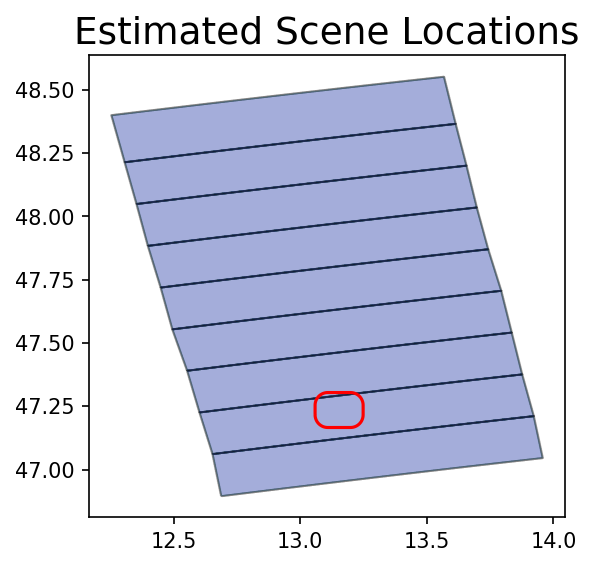

In [ ]:
sbas.plot_scenes(AOI)

## Reframe Scenes (Optional)

Stitch sequential scenes and crop the subswath to a smaller area for faster processing when the full area is not needed.

In [ ]:
sbas.compute_reframe(AOI)

Reframing:   0%|          | 0/62 [00:00<?, ?it/s]

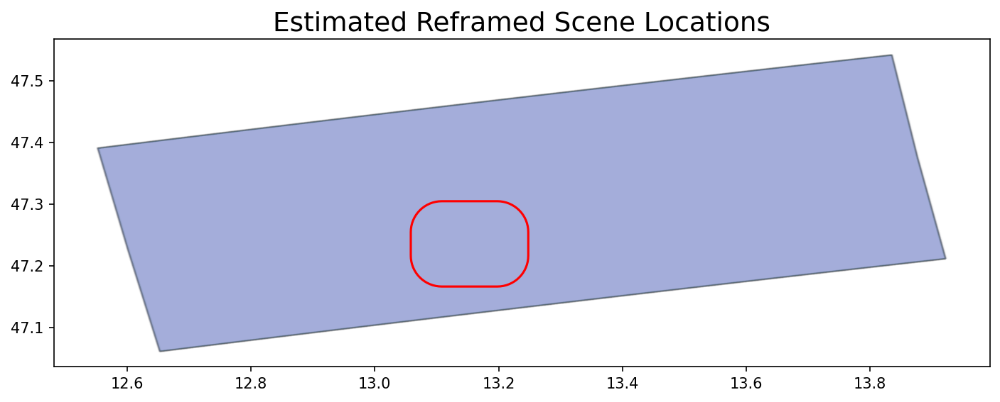

In [ ]:
sbas.plot_scenes(AOI, caption='Estimated Reframed Scene Locations')

### Download SRTM DEM

The function below downloads SRTM1 or SRTM3 DEM and converts heights to ellipsoidal model using EGM96 grid.
Besides, for faster processing we can use pre-defined DEM file as explained above. Select product=SRTM1 for 30m resolution and product=SRTM3 for 90m resolution SRTM DEM.

In [ ]:
# define the area of interest (AOI) to speedup the processing
sbas.download_dem(AOI)

DEM Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

## Load Copernicus DEM

In [ ]:
# download the tile
#!wget -c https://copernicus-dem-30m.s3.amazonaws.com/Copernicus_DSM_COG_10_N47_00_E013_00_DEM/Copernicus_DSM_COG_10_N47_00_E013_00_DEM.tif

In [ ]:
# load the tile
#sbas.load_dem('Copernicus_DSM_COG_10_N47_00_E013_00_DEM.tif', AOI)

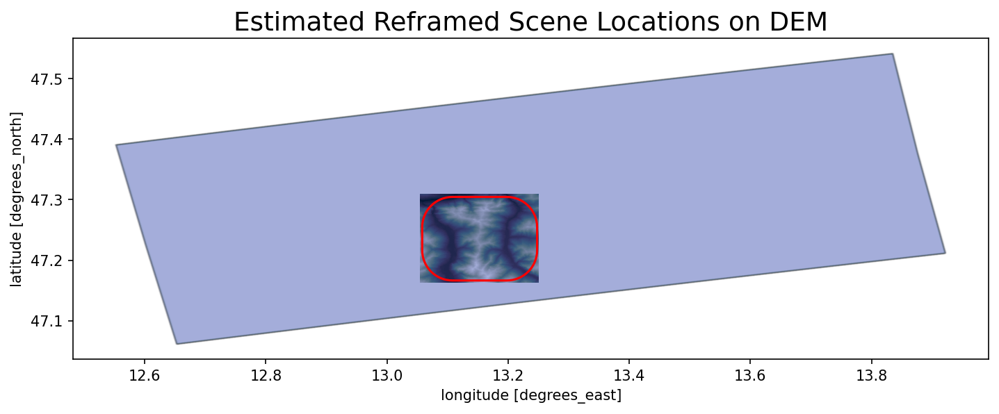

In [ ]:
sbas.plot_scenes(AOI, caption='Estimated Reframed Scene Locations on DEM')

## Align Images

In [ ]:
sbas.compute_align()

Aligning Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning Repeat:   0%|          | 0/61 [00:00<?, ?it/s]

Convert Subswath:   0%|          | 0/62 [00:00<?, ?it/s]

## Backup

In [ ]:
# bursts-cropped GeoTIFF files moved into backup directory
sbas.backup('backup')

In [ ]:
# free disk space removing the cropped Sentinel-1 GeoTIFFs
!rm -fr backup

## Geocoding Transform

In [ ]:
# use the original Sentinel-1 resolution (1 pixel spacing)
sbas.compute_geocode(1)

Radar Transform Computing:   0%|          | 0/2 [00:00<?, ?it/s]

Radar Transform Saving:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-5b8d5694-aac6-11ee-82e8-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46126
INFO:distributed.scheduler:Receive client connection: Client-worker-5b8cd79c-aac6-11ee-82eb-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46142
INFO:distributed.scheduler:Receive client connection: Client-worker-5b8e6c62-aac6-11ee-82ed-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46150
INFO:distributed.scheduler:Receive client connection: Client-worker-5b9b0053-aac6-11ee-82e5-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46164


Radar Transform Indexing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Inverse Transform Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
topo = sbas.get_topo()
topo

<xarray.DataArray 'topo' (y: 1332, x: 4872)>
dask.array<xarray-ele, shape=(1332, 4872), dtype=float32, chunksize=(1332, 2048), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 204.5 205.5 206.5 ... 1.534e+03 1.534e+03 1.536e+03
  * x        (x) float64 8.378e+03 8.38e+03 8.38e+03 ... 1.325e+04 1.325e+04

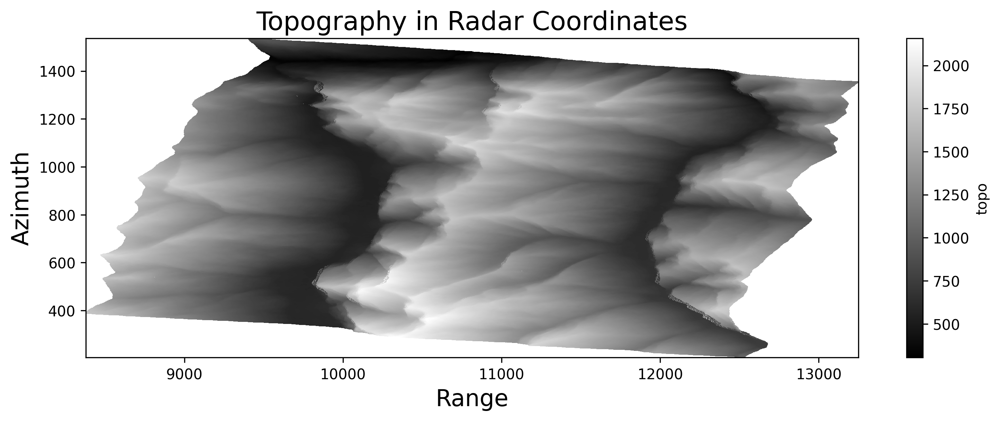

In [ ]:
sbas.plot_topo()

## Persistent Scatterers Function (PSF)

In [ ]:
# use the only selected dates for the pixels stability analysis
sbas.compute_ps()

Intensity Normalization:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Compute Stability Measures:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
psfunction = sbas.psfunction()
psfunction

<xarray.DataArray 'psf' (y: 1332, x: 4872)>
dask.array<truediv, shape=(1332, 4872), dtype=float32, chunksize=(1332, 2048), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 204.5 205.5 206.5 ... 1.534e+03 1.534e+03 1.536e+03
  * x        (x) float64 8.378e+03 8.38e+03 8.38e+03 ... 1.325e+04 1.325e+04

In [ ]:
sbas.plot_psfunction()

El resultado de esta celda es demasiado grande y solo se puede mostrar si se inicia sesión.


## SBAS Baseline

In [ ]:
baseline_pairs = sbas.sbas_pairs(days=200)
# optionally, drop dates having less then 2 pairs
#baseline_pairs = sbas.sbas_pairs_limit(baseline_pairs, limit=3, iterations=2)
# optionally, drop all pairs connected to the specified dates
# exaclude very large baseline (278m) scene
#baseline_pairs = sbas.sbas_pairs_filter_dates(baseline_pairs, ['2023-01-18'])
baseline_pairs

,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel
0,2021-05-16,2021-05-28,30.67,37.43,2021-05-16 2021-05-28,6.76,12,NaT
1,2021-05-16,2021-06-09,30.67,31.81,2021-05-16 2021-06-09,1.14,24,NaT
2,2021-05-16,2021-06-21,30.67,26.25,2021-05-16 2021-06-21,-4.42,36,NaT
3,2021-05-16,2021-07-03,30.67,-18.64,2021-05-16 2021-07-03,-49.31,48,NaT
4,2021-05-16,2021-07-15,30.67,-34.63,2021-05-16 2021-07-15,-65.30,60,NaT
...,...,...,...,...,...,...,...,...
835,2023-04-24,2023-05-18,-4.54,-5.47,2023-04-24 2023-05-18,-0.93,24,NaT
836,2023-04-24,2023-05-30,-4.54,-23.89,2023-04-24 2023-05-30,-19.35,36,NaT
837,2023-05-06,2023-05-18,-7.87,-5.47,2023-05-06 2023-05-18,2.40,12,NaT
838,2023-05-06,2023-05-30,-7.87,-23.89,2023-05-06 2023-05-30,-16.02,24,NaT


In [ ]:
sbas.plot_baseline(baseline_pairs)

El resultado de esta celda es demasiado grande y solo se puede mostrar si se inicia sesión.


## SBAS Analysis

Initially, we encounter a wide range of interferogram pairs, varying significantly in quality. Some are excessively noisy, while others exhibit markedly better characteristics. There's no practical necessity to process all interferograms comprehensively, as we can readily estimate their average correlation to identify the most promising ones. Although the correlation is influenced by processing parameters, the pairs with the highest coherence consistently emerge as the best options, making the specifics of these parameters less critical for selection. It's important to note, however, that correlation is a spatial measure and isn't applicable to single pixel values, implying the necessity for some Gaussian filtering.

In [ ]:
# select subset of pairs or use all the pairs
#pairs, dates = sbas.get_pairs(baseline_pairs[:9], dates=True)
# or select real pairs when 'rel' is not defined (not a time)
#pairs, dates = sbas.get_pairs(baseline_pairs[np.isnat(baseline_pairs.rel)], dates=True)
pairs, dates = sbas.get_pairs(baseline_pairs, dates=True)

In [ ]:
# load Sentinel-1 data
data = sbas.open_data(dates)
# Gaussian filtering N meter cut-off wavelength with multilooking on Sentinel-1 intensities
intensity = sbas.multilooking(np.square(np.abs(data)), wavelength=200, coarsen=(1,4))
# calculate phase difference with topography correction
phasediff = sbas.phasediff(pairs, data)
# Gaussian filtering N meter cut-off wavelength with multilooking
phase = sbas.multilooking(phasediff, weight=psfunction, wavelength=200, coarsen=(1,4))
corr = sbas.correlation(phase, intensity)
# convert complex phase difference to interferogram
intf = sbas.interferogram(phase)

INFO:distributed.core:Event loop was unresponsive in Nanny for 3.38s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.44s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.44s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.46s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.46s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

In [ ]:
# optionally, materialize to disk and open
intf_corr0 = sbas.sync_cube(xr.merge([intf, corr]), 'intf_corr0')
intf0 = intf_corr0.phase
corr0 = intf_corr0.correlation

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.core:Event loop was unresponsive in Nanny for 5.31s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.31s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 5.32s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.32s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.32s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

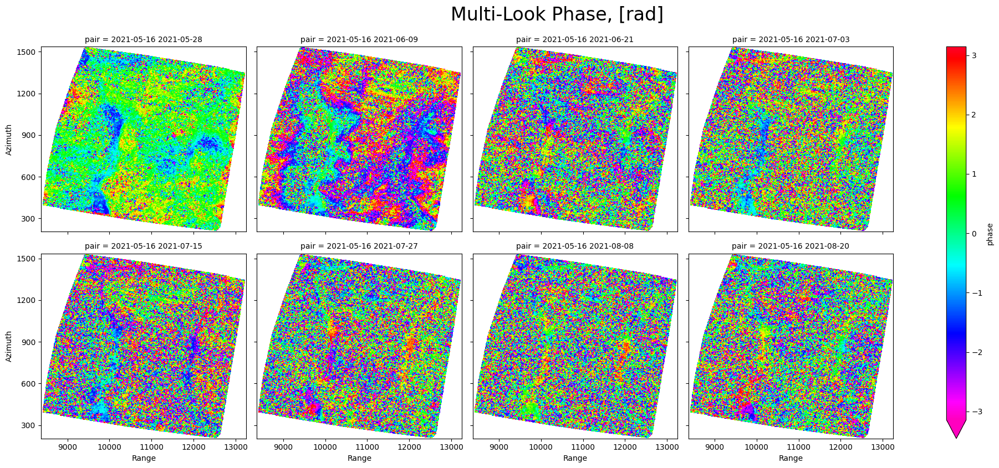

In [ ]:
sbas.plot_interferograms(intf0[:8], caption='Multi-Look Phase, [rad]')

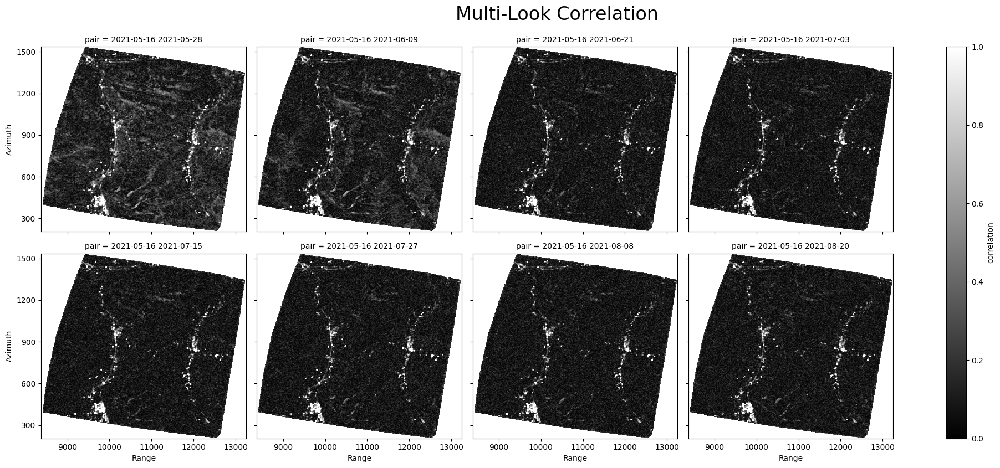

In [ ]:
sbas.plot_correlations(corr0[:8], caption='Multi-Look Correlation')

### Select Well Correlated Pairs

In [ ]:
baseline_pairs['corr'] = corr0.mean(['y', 'x'])
baseline_pairs

,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel,corr
0,2021-05-16,2021-05-28,30.67,37.43,2021-05-16 2021-05-28,6.76,12,NaT,0.187581
1,2021-05-16,2021-06-09,30.67,31.81,2021-05-16 2021-06-09,1.14,24,NaT,0.154876
2,2021-05-16,2021-06-21,30.67,26.25,2021-05-16 2021-06-21,-4.42,36,NaT,0.120987
3,2021-05-16,2021-07-03,30.67,-18.64,2021-05-16 2021-07-03,-49.31,48,NaT,0.117552
4,2021-05-16,2021-07-15,30.67,-34.63,2021-05-16 2021-07-15,-65.30,60,NaT,0.119342
...,...,...,...,...,...,...,...,...,...
835,2023-04-24,2023-05-18,-4.54,-5.47,2023-04-24 2023-05-18,-0.93,24,NaT,0.172546
836,2023-04-24,2023-05-30,-4.54,-23.89,2023-04-24 2023-05-30,-19.35,36,NaT,0.124923
837,2023-05-06,2023-05-18,-7.87,-5.47,2023-05-06 2023-05-18,2.40,12,NaT,0.190917
838,2023-05-06,2023-05-30,-7.87,-23.89,2023-05-06 2023-05-30,-16.02,24,NaT,0.185155


In [ ]:
# select the best correlated interferograms
corr_threshold = baseline_pairs['corr'].quantile(0.8).round(2)
corr_threshold

In [ ]:
# pairs_best = baseline_pairs[(baseline_pairs['corr']>=baseline_pairs['corr'].quantile(0.20))\
#                             &(baseline_pairs['stddev']<=baseline_pairs['stddev'].quantile(0.80))]
pairs_best = baseline_pairs[baseline_pairs['corr']>=corr_threshold]
pairs_best

,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel,corr
0,2021-05-16,2021-05-28,30.67,37.43,2021-05-16 2021-05-28,6.76,12,NaT,0.187581
1,2021-05-16,2021-06-09,30.67,31.81,2021-05-16 2021-06-09,1.14,24,NaT,0.154876
16,2021-05-28,2021-06-09,37.43,31.81,2021-05-28 2021-06-09,-5.62,12,NaT,0.185720
17,2021-05-28,2021-06-21,37.43,26.25,2021-05-28 2021-06-21,-11.18,24,NaT,0.131983
32,2021-06-09,2021-06-21,31.81,26.25,2021-06-09 2021-06-21,-5.56,12,NaT,0.145700
...,...,...,...,...,...,...,...,...,...
834,2023-04-24,2023-05-06,-4.54,-7.87,2023-04-24 2023-05-06,-3.33,12,NaT,0.182980
835,2023-04-24,2023-05-18,-4.54,-5.47,2023-04-24 2023-05-18,-0.93,24,NaT,0.172546
837,2023-05-06,2023-05-18,-7.87,-5.47,2023-05-06 2023-05-18,2.40,12,NaT,0.190917
838,2023-05-06,2023-05-30,-7.87,-23.89,2023-05-06 2023-05-30,-16.02,24,NaT,0.185155


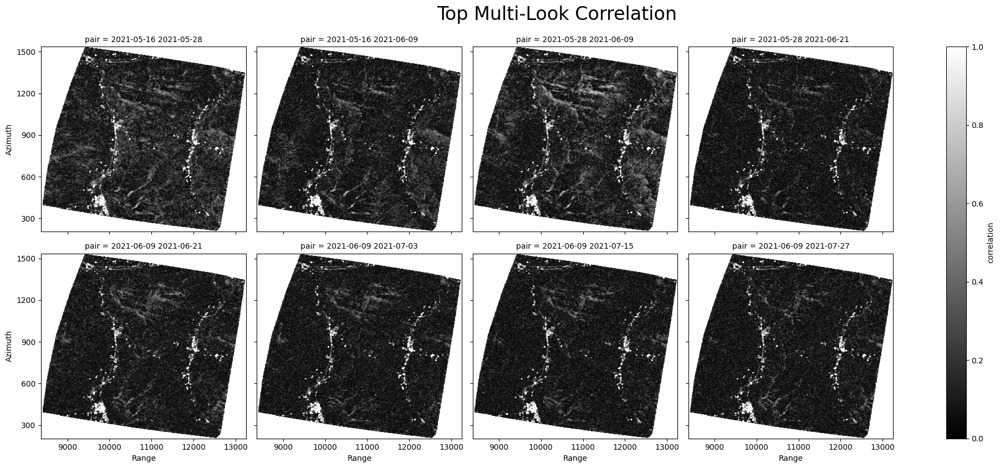

In [ ]:
sbas.plot_correlations(corr0.sel(pair=pairs_best.pair.values)[:8], caption='Top Multi-Look Correlation')

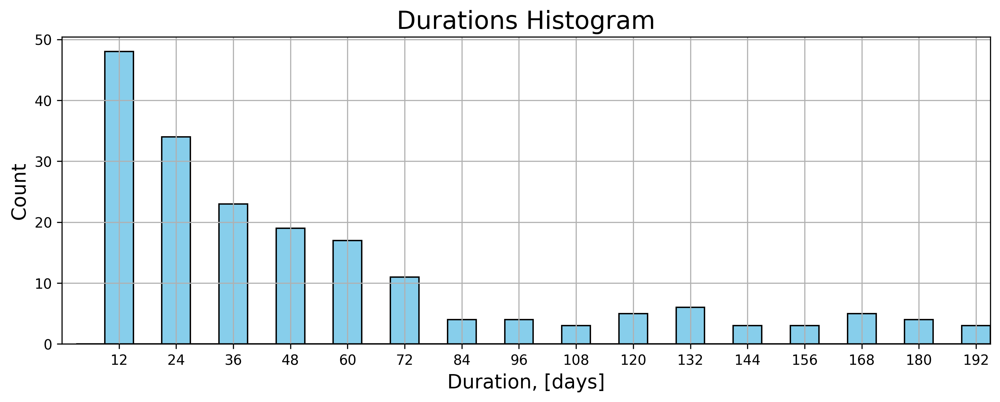

In [ ]:
sbas.plot_baseline_duration(pairs_best)

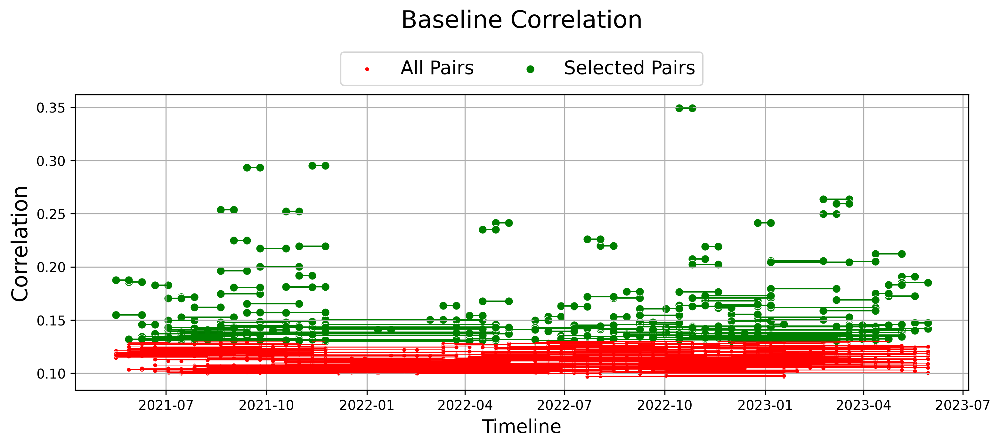

In [ ]:
sbas.plot_baseline_correlation(baseline_pairs, pairs_best)

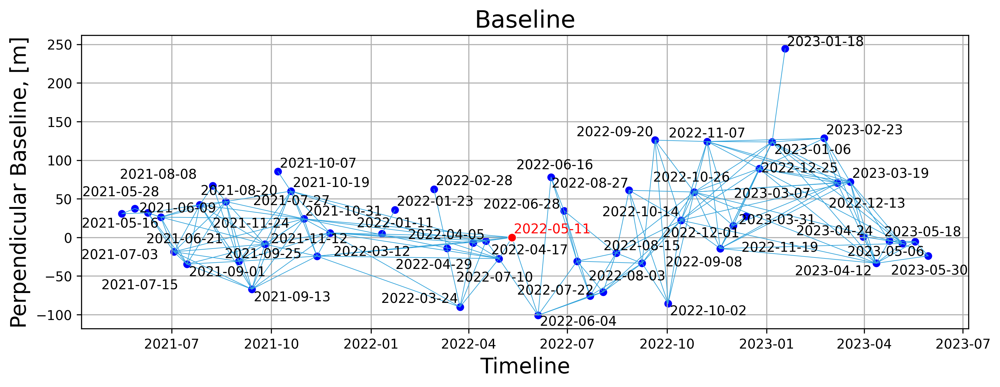

In [ ]:
sbas.plot_baseline(pairs_best)

### Open the Selected Pairs

In [ ]:
intf0 = intf_corr0.phase.sel(pair=pairs_best.pair.values)
corr0 = intf_corr0.correlation.sel(pair=pairs_best.pair.values)

### 2D Unwrapping

In [ ]:
unwrap0 = sbas.unwrap_snaphu(intf0, corr0, conncomp=True)
unwrap0

In [ ]:
# optionally, materialize to disk and open
unwrap0 = sbas.sync_cube(unwrap0, 'unwrap0')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.core:Event loop was unresponsive in Nanny for 3.56s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 3.57s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 3.58s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 4.16s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 4.17s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

In [ ]:
sbas.plot_phases((unwrap0.phase - unwrap0.phase.mean(['y', 'x']))[:8], caption='Phase - Average, [rad]')

El resultado de esta celda es demasiado grande y solo se puede mostrar si se inicia sesión.


In [ ]:
sbas.plot_conncomps(unwrap0.conncomp[:8])

## Trend Phase

In [ ]:
topo = sbas.get_topo().coarsen({'x': 4}, boundary='trim').mean()
yy, xx = xr.broadcast(topo.y, topo.x)
trend = sbas.regression_linear(unwrap0.phase,
        [topo,    topo*yy,    topo*xx,    topo*yy**2,
         topo**2, topo**2*yy, topo**2*xx, topo**2*yy*xx,
         topo**3, topo**3*yy, topo**3*xx, topo**3*yy*xx,
         yy, xx,
         yy**2, xx**2, yy*xx,
         yy**3, xx**3, yy**2*xx, xx**2*yy], corr0)
trend

In [ ]:
# optionally, materialize to disk and open
trend = sbas.sync_cube(trend, 'trend')

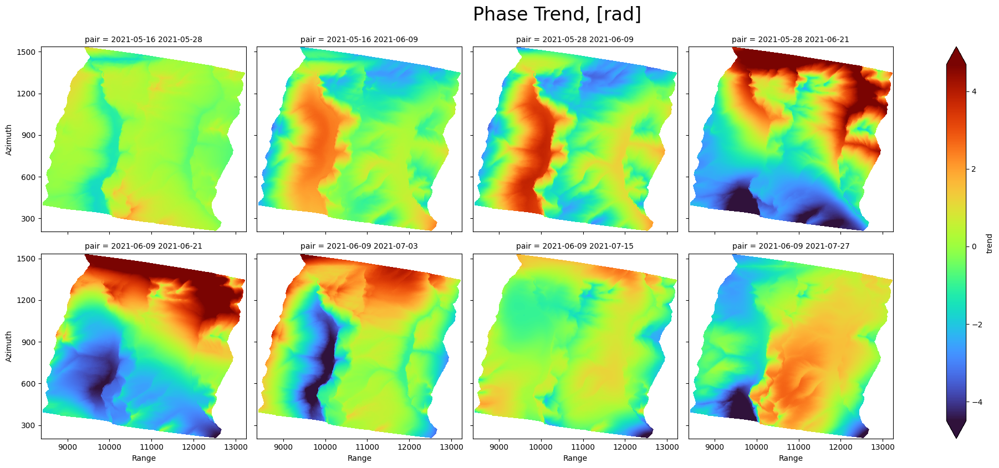

In [ ]:
zmin, zmax = np.nanquantile(trend - trend.mean(['y', 'x']), [0.01, 0.99])
sbas.plot_phases((trend - trend.mean(['y', 'x']))[:8], caption='Phase Trend, [rad]', vmin=zmin, vmax=zmax)

## PS Analysis

In [ ]:
# load Sentinel-1 data
data = sbas.open_data(dates)
# Gaussian filtering N meter cut-off wavelength with multilooking on Sentinel-1 intensities
intensity = sbas.multilooking(np.square(np.abs(data)), wavelength=200, coarsen=None)
# calculate phase difference with topography correction
phasediff = sbas.phasediff(pairs_best, data, phase=trend)
# Gaussian filtering N meter cut-off wavelength with multilooking
phase = sbas.multilooking(phasediff, weight=psfunction, wavelength=200, coarsen=None)
corr = sbas.correlation(phase, intensity)
# convert complex phase difference to interferogram
intf = sbas.interferogram(phase)

In [ ]:
# optionally, materialize to disk and open
intf_corr = sbas.sync_cube(xr.merge([intf, corr]), 'intf_corr')
intf = intf_corr.phase
corr = intf_corr.correlation

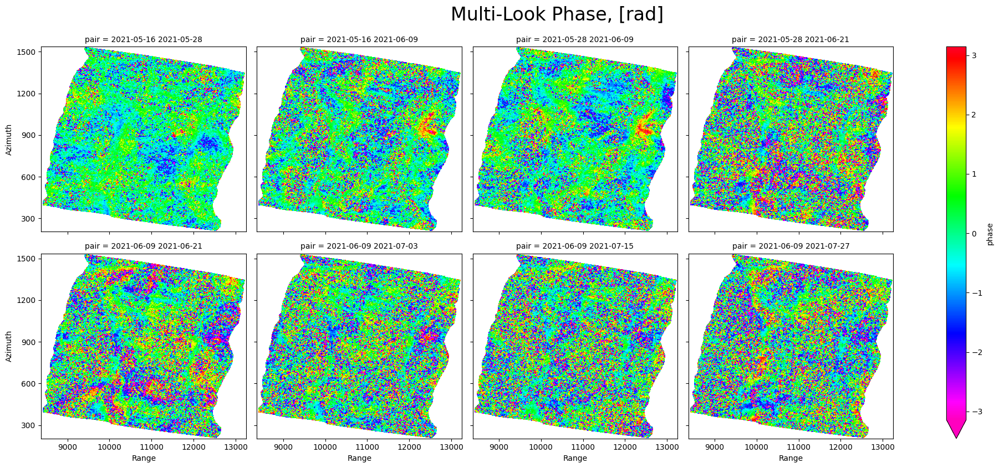

In [ ]:
sbas.plot_interferograms(intf[:8], caption='Multi-Look Phase, [rad]')

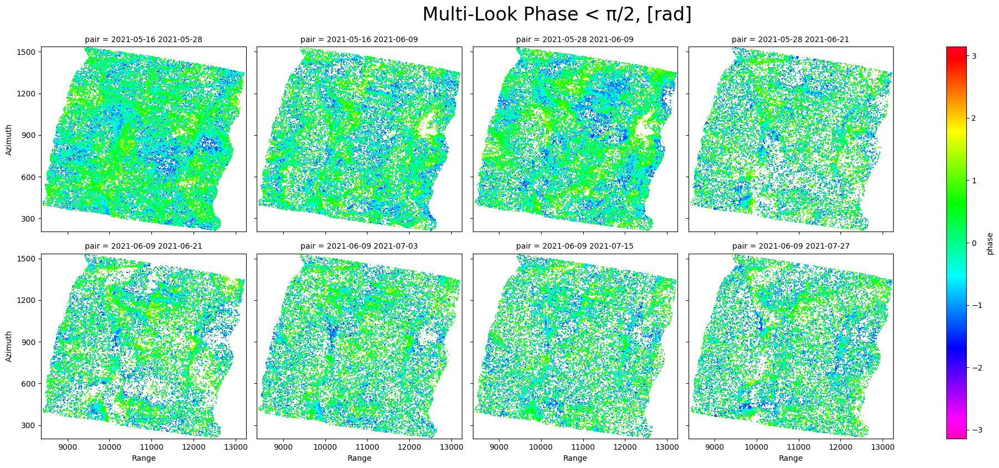

In [ ]:
sbas.plot_interferograms(intf.where(abs(intf)<np.pi/2)[:8], caption='Multi-Look Phase < π/2, [rad]')

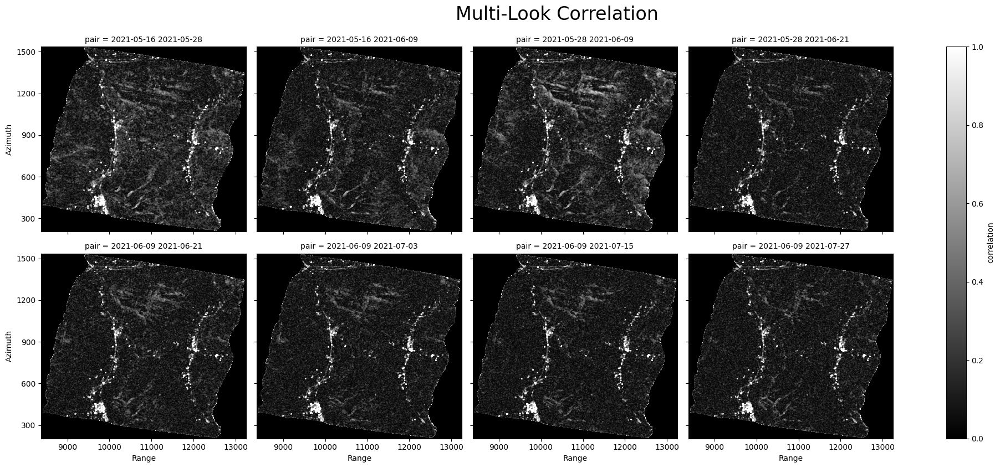

In [ ]:
sbas.plot_correlations(corr.fillna(0)[:8], caption='Multi-Look Correlation')

In [ ]:
corr_stack = corr.mean('pair').compute()

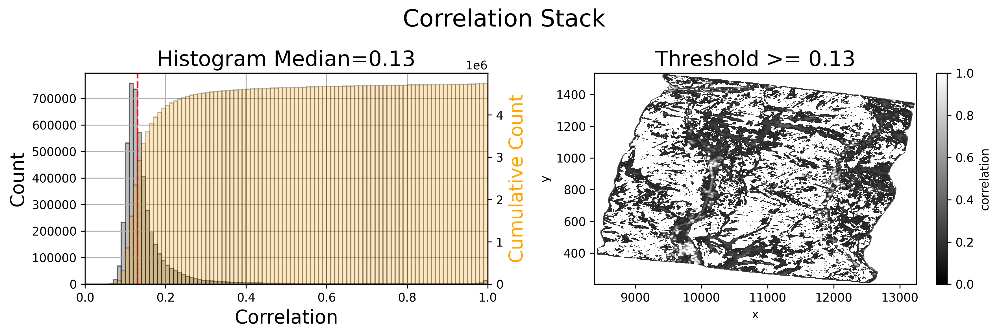

In [ ]:
sbas.plot_correlation_stack(corr_stack)

0.6072692


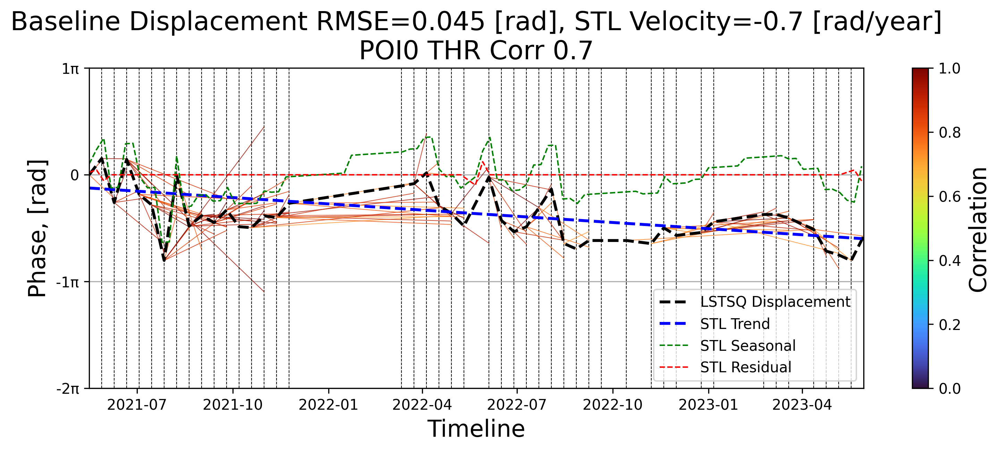

In [ ]:
geom = sbas.geocode(POI0).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
threshold = 0.7
sbas.plot_baseline_displacement(data.where(weight>=threshold, drop=True),
                            weight.where(weight>=threshold, drop=True),
                           caption='POI0 THR Corr 0.7')

0.6072692


INFO:distributed.utils_perf:full garbage collection released 319.43 MiB from 151695 reference cycles (threshold: 9.54 MiB)


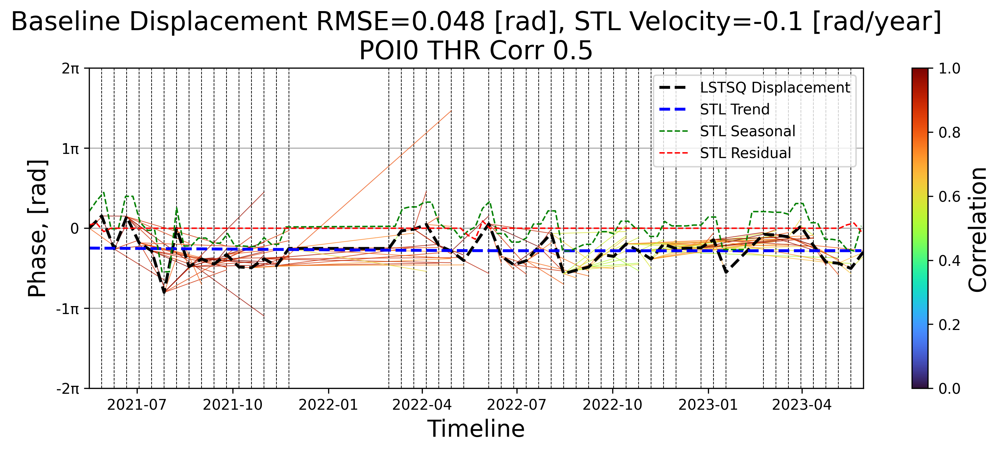

In [ ]:
geom = sbas.geocode(POI0).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
threshold = 0.5
sbas.plot_baseline_displacement(data.where(weight>=threshold, drop=True),
                                weight.where(weight>=threshold, drop=True),
                               caption='POI0 THR Corr 0.5')

0.6072692


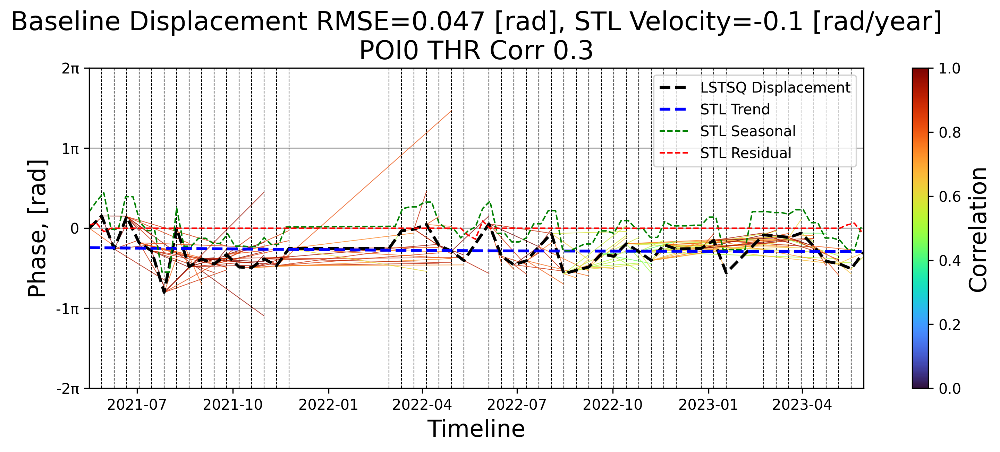

In [ ]:
geom = sbas.geocode(POI0).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
threshold = 0.3
sbas.plot_baseline_displacement(data.where(weight>=threshold, drop=True),
                                weight.where(weight>=threshold, drop=True),
                               caption='POI0 THR Corr 0.3')

0.6072692


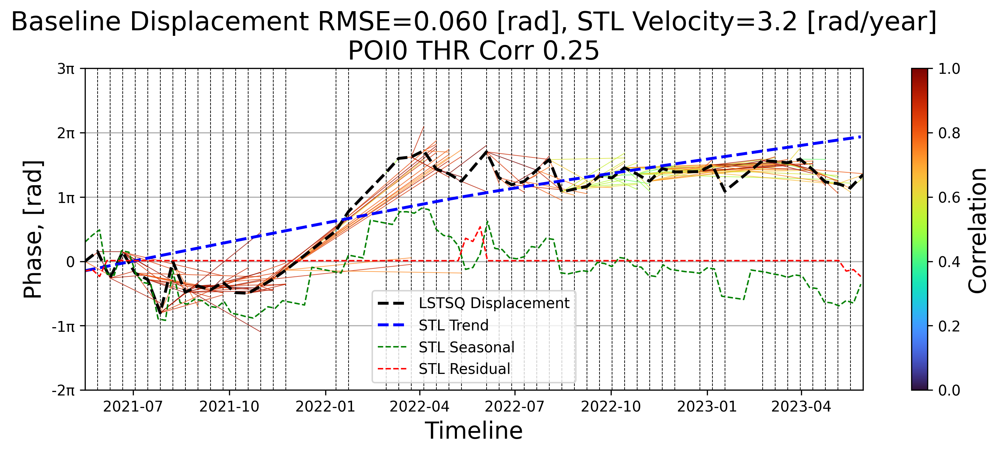

In [ ]:
geom = sbas.geocode(POI0).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
threshold = 0.25
sbas.plot_baseline_displacement(data.where(weight>=threshold, drop=True),
                                weight.where(weight>=threshold, drop=True),
                               caption='POI0 THR Corr 0.25')

0.6072692


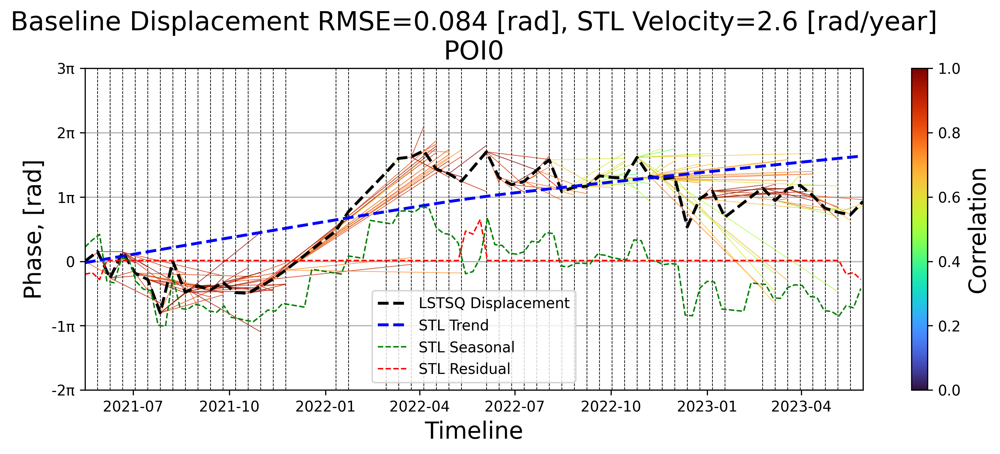

In [ ]:
geom = sbas.geocode(POI0).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
sbas.plot_baseline_displacement(data, weight, caption='POI0')

0.5613382


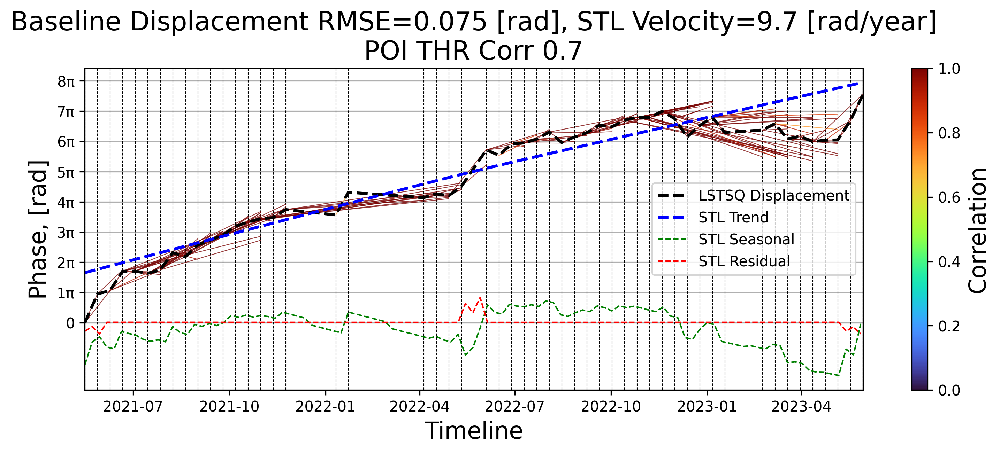

In [ ]:
geom = sbas.geocode(POI).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
threshold = 0.7
sbas.plot_baseline_displacement(data.where(weight>=threshold, drop=True),
                                weight.where(weight>=threshold, drop=True),
                               caption='POI THR Corr 0.7')

0.5613382


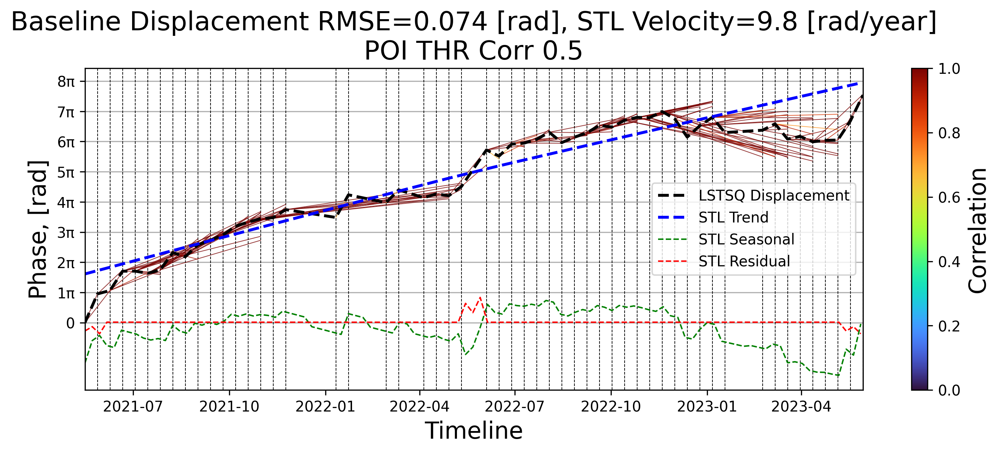

In [ ]:
geom = sbas.geocode(POI).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
threshold = 0.5
sbas.plot_baseline_displacement(data.where(weight>=threshold, drop=True),
                                weight.where(weight>=threshold, drop=True),
                               caption='POI THR Corr 0.5')

0.5613382


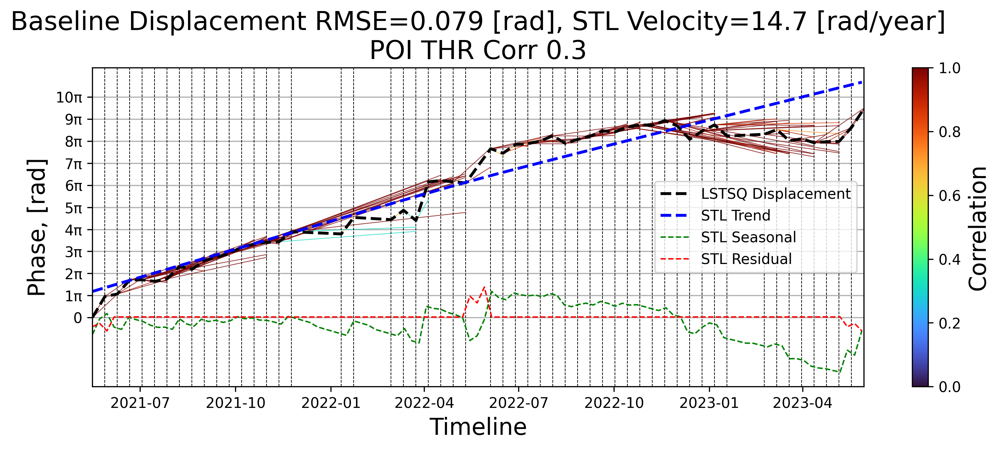

In [ ]:
geom = sbas.geocode(POI).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
threshold = 0.3
sbas.plot_baseline_displacement(data.where(weight>=threshold, drop=True),
                                weight.where(weight>=threshold, drop=True),
                               caption='POI THR Corr 0.3')

0.5613382


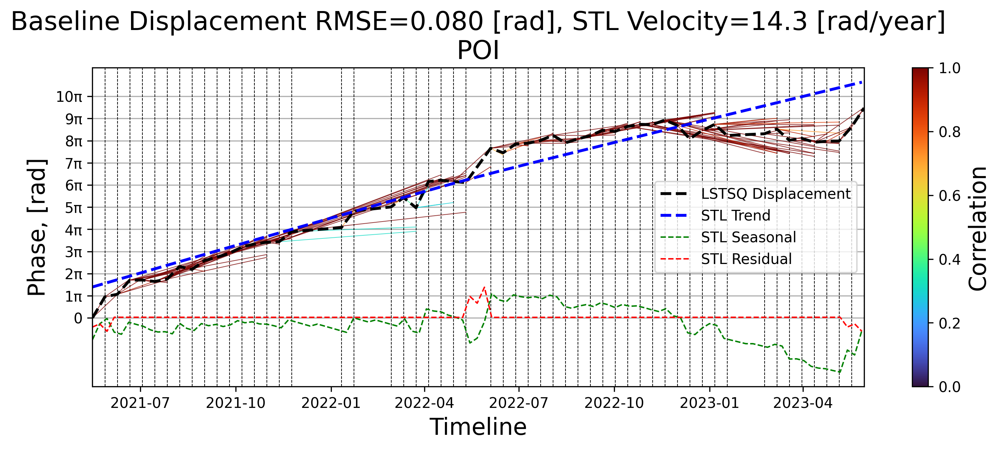

In [ ]:
geom = sbas.geocode(POI).geometry[0]
x, y = geom.x, geom.y
print (psfunction.sel(y=y, x=x, method='nearest').values)
data = intf.sel(y=y, x=x, method='nearest').compute()
weight = corr.sel(y=y, x=x, method='nearest').compute()
sbas.plot_baseline_displacement(data, weight, caption='POI')

## 1D Unwrapping

In [ ]:
#Stack.unwrap1d = unwrap1d
# use correlation stack median to speedup the calculations filtering out low-correlation pixels
#phase = sbas.unwrap1d(intf, corr.where(corr_stack>0.26).where(corr>0.3))
phase = sbas.unwrap1d(intf.where(corr>0.3), corr)

In [ ]:
phase = sbas.sync_cube(phase, 'phase')

## Correlation-Weighted Least-Squares Solution

In [ ]:
# calculate phase displacement in radians
disp = sbas.lstsq(phase, corr)

In [ ]:
# optionally, materialize to disk and open
disp = sbas.sync_cube(disp, 'disp')

In [ ]:
rmse = sbas.rmse(phase, disp, corr)
rmse

In [ ]:
# optionally, materialize to disk and open
rmse = sbas.sync_cube(rmse, 'rmse')

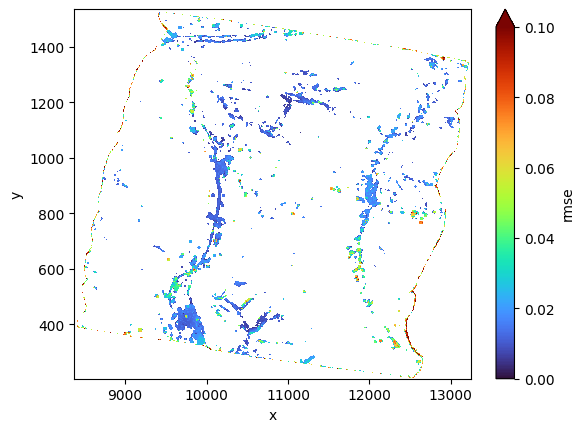

In [ ]:
rmse.where(rmse>0).plot.imshow(vmin=0, vmax=0.1, cmap='turbo')

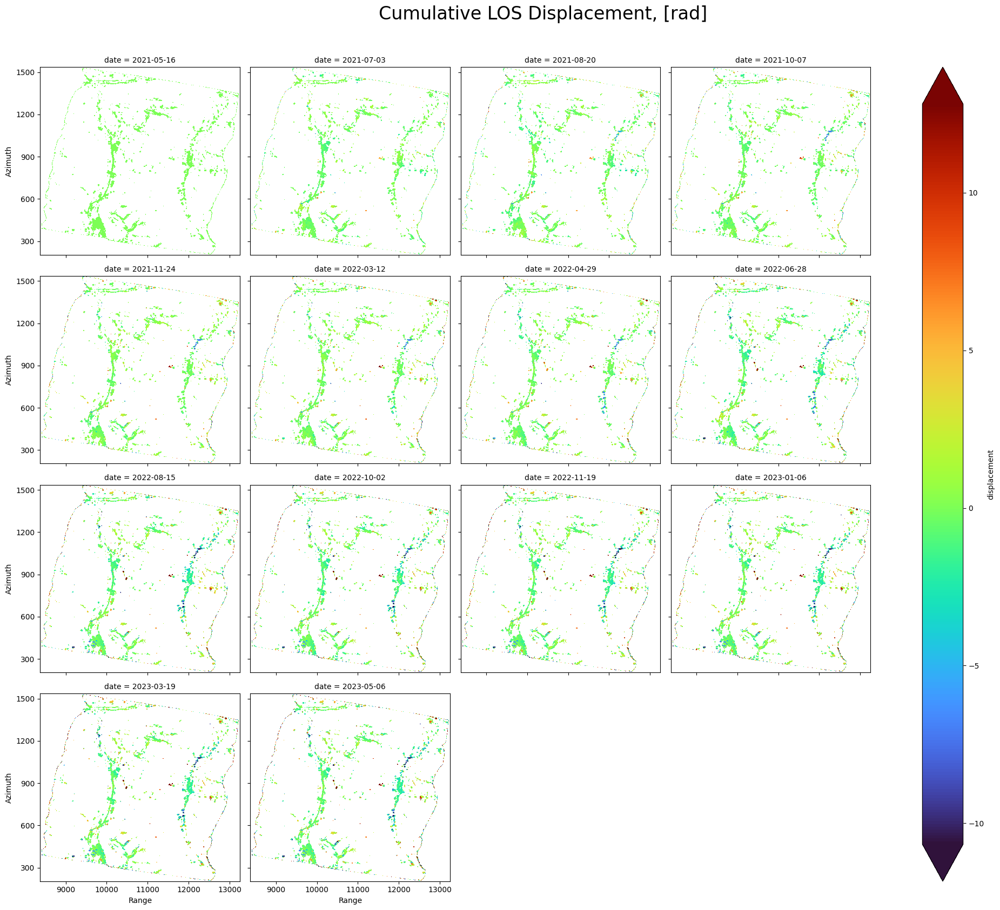

In [ ]:
zmin, zmax = np.nanquantile(disp.where(corr_stack>0.5), [0.01, 0.99])
sbas.plot_displacement(disp[::4], vmin=zmin, vmax=zmax)

### STL model for LOS Displacement, mm

In [ ]:
stl = sbas.stl(disp)
stl

In [ ]:
# optionally, materialize to disk and open
stl = sbas.sync_cube(stl, 'stl')

In [ ]:
years = ((stl.date.max() - stl.date.min()).dt.days/365.25).item()
print ('years', np.round(years, 3))
# for linear trend
velocity = (stl.trend[-1] - stl.trend[0])/years
velocity

INFO:distributed.scheduler:Receive client connection: Client-worker-6dbc9a18-aada-11ee-9050-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:38484
INFO:distributed.scheduler:Receive client connection: Client-worker-6dcab412-aada-11ee-904a-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:38492


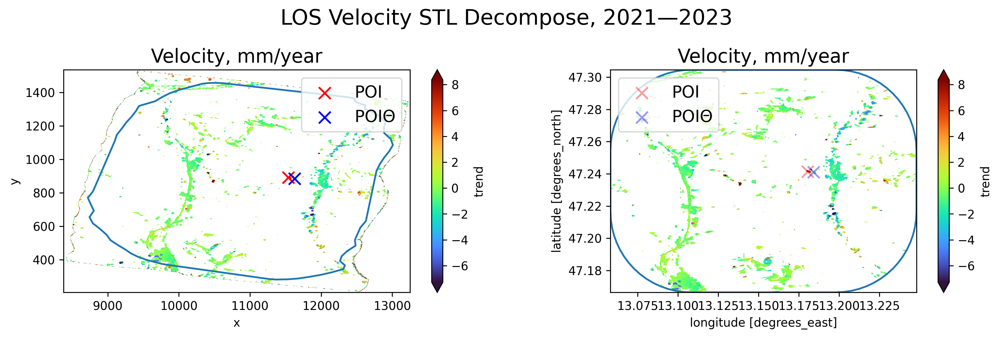

In [ ]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity, [0.01, 0.99])

ax = fig.add_subplot(1, 2, 1)
velocity.plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
sbas.geocode(AOI.boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
sbas.geocode(POI0).plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.set_aspect('auto')
ax.legend(fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity.where(rmse<=0.1))).rio.clip(AOI.geometry)\
    .plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
AOI.boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', alpha=0.4, markersize=100, label='POI')
POI0.plot(ax=ax, marker='x', c='b', alpha=0.4, markersize=100, label='POI$\Theta$')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('LOS Velocity STL Decompose, 2021—2023', fontsize=18)
plt.tight_layout()
plt.show()

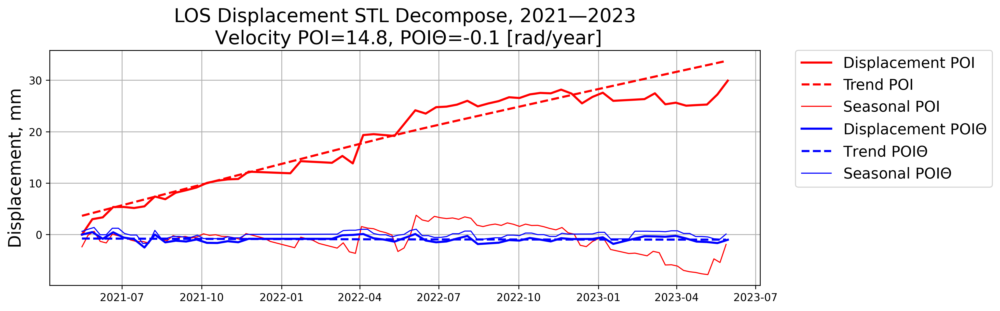

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp.sel(y=y, x=x, method='nearest')
stl_pixel = stl.sel(y=y, x=x, method='nearest')
velocity_pixel = float(velocity.sel(y=y, x=x, method='nearest'))
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI0).geometry][0]
disp_pixel = disp.sel(y=y, x=x, method='nearest')
stl_pixel = stl.sel(y=y, x=x, method='nearest')
velocity_pixel0 = float(velocity.sel(y=y, x=x, method='nearest'))
plt.plot(disp_pixel.date, disp_pixel, c='b', lw=2, label='Displacement POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.trend, c='b', ls='--', lw=2, label='Trend POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='b', lw=1, label='Seasonal POI$\Theta$')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title(f'LOS Displacement STL Decompose, 2021—2023\n Velocity POI={velocity_pixel:0.1f}, POI$\Theta$={velocity_pixel0:0.1f} [rad/year]', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.grid()
plt.show()

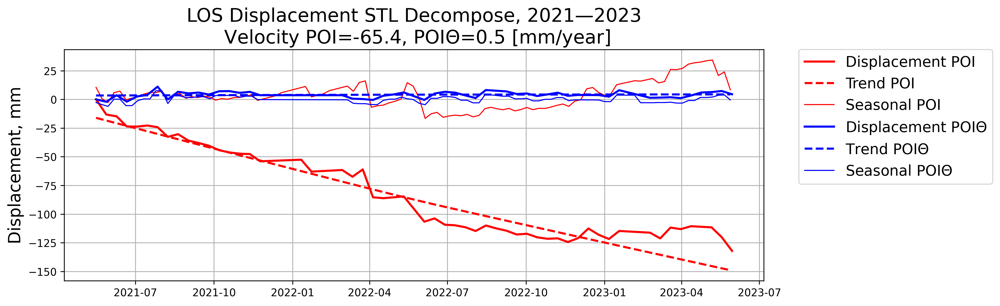

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = sbas.los_displacement_mm(disp.sel(y=y, x=x, method='nearest'))
stl_pixel = sbas.los_displacement_mm(stl.sel(y=y, x=x, method='nearest'))
velocity_pixel = float(sbas.los_displacement_mm(velocity.sel(y=y, x=x, method='nearest')))
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI0).geometry][0]
disp_pixel = sbas.los_displacement_mm(disp.sel(y=y, x=x, method='nearest'))
stl_pixel = sbas.los_displacement_mm(stl.sel(y=y, x=x, method='nearest'))
velocity_pixel0 = float(sbas.los_displacement_mm(velocity.sel(y=y, x=x, method='nearest')))
plt.plot(disp_pixel.date, disp_pixel, c='b', lw=2, label='Displacement POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.trend, c='b', ls='--', lw=2, label='Trend POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='b', lw=1, label='Seasonal POI$\Theta$')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title(f'LOS Displacement STL Decompose, 2021—2023\n Velocity POI={velocity_pixel:0.1f}, POI$\Theta$={velocity_pixel0:0.1f} [mm/year]', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.grid()
plt.show()

## 3D VTK Export

In [ ]:
# convert rad to mm
velocity_ll = sbas.ra2ll(sbas.los_displacement_mm(velocity))

In [ ]:
dem = sbas.get_dem()

In [ ]:
gmap_tiles = XYZTiles().download(velocity_ll, 14)

In [ ]:
ds = xr.merge([dem.interp_like(velocity_ll, method='cubic').rename('z'),
               gmap_tiles.interp_like(velocity_ll, method='cubic').round().astype(np.uint8),
               velocity_ll])
# convert to VTK structure
vtk_grid = pv.StructuredGrid(NCubeVTK.ImageOnTopography(ds.rename({'lat': 'y', 'lon': 'x'})))
vtk_grid.save('velocity.vtk')
print (vtk_grid)

## Export GeoJSON, GeoTIFF, VTK files from Google Colab

In [ ]:
# GeoTIFF export
sbas.as_geo(velocity_ll).rio.to_raster('velocity.tif')

In [ ]:
# GeoJSON export
df = velocity_ll.stack(points=['lat', 'lon']).dropna(dim='points').to_dataframe()
df = gpd.GeoDataFrame(df['los'].values,
                 geometry=gpd.points_from_xy(df['lon'].values, df['lat'].values),
                 columns=['velocity'])
df.to_file('velocity.json', driver='GeoJSON')

In [ ]:
# allow to download; alternatively, these files available in file manager panel
if 'google.colab' in sys.modules:
    from google.colab import files
    files.download('velocity.tif')
    files.download('velocity.json')
    files.download('velocity.vtk')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>